In [1]:
from src.data_loader import *

In [2]:
from sklearn.model_selection import train_test_split

In [32]:
import pandas as pd
import numpy as np
from sklearn import metrics

import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.model_selection import ParameterGrid

from statsmodels.tsa.api import SimpleExpSmoothing
from statsmodels.tsa.api import Holt
from statsmodels.tsa.api import ExponentialSmoothing
import statsmodels as sm

In [4]:
def mean_absolute_percentage_error_func(y_true, y_pred):
    '''
    Calculate the mean absolute percentage error as a metric for evaluation
    
    Args:
        y_true (float64): Y values for the dependent variable (test part), numpy array of floats 
        y_pred (float64): Predicted values for the dependen variable (test parrt), numpy array of floats
    
    Returns:
        Mean absolute percentage error 
    '''    
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [5]:
def timeseries_evaluation_metrics_func(y_true, y_pred):
    '''
    Calculate the following evaluation metrics:
        - MSE
        - MAE
        - RMSE
        - MAPE
        - R²
    
    Args:
        y_true (float64): Y values for the dependent variable (test part), numpy array of floats 
        y_pred (float64): Predicted values for the dependen variable (test parrt), numpy array of floats
    
    Returns:
        MSE, MAE, RMSE, MAPE and R² 
    '''    
    print('Evaluation metric results: ')
    print(f'MSE is : {metrics.mean_squared_error(y_true, y_pred)}')
    print(f'MAE is : {metrics.mean_absolute_error(y_true, y_pred)}')
    print(f'RMSE is : {np.sqrt(metrics.mean_squared_error(y_true, y_pred))}')
    print(f'MAPE is : {mean_absolute_percentage_error_func(y_true, y_pred)}')
    print(f'R2 is : {metrics.r2_score(y_true, y_pred)}',end='\n\n')

In [6]:
data = DataGenerator('db').data_search('AAPL')

기존 데이터 불러오기 성공


In [7]:
data.sort_index(ascending=True, inplace=True)

In [8]:
# X_train, X_test, y_train, y_test = train_test_split(data.drop('Adj Close', axis = 1), data['Adj Close'], test_size=0.2, random_state=42)
size = 0.85
X_train, X_test = data['Adj Close'][:int(len(data)*size)], data['Adj Close'][int(len(data)*size):]


In [9]:
X_test

Datetime
2018-05-11     45.263878
2018-05-14     45.158268
2018-05-15     44.747856
2018-05-16     45.165474
2018-05-17     44.879856
                 ...    
2022-10-28    155.740005
2022-10-31    153.339996
2022-11-01    150.649994
2022-11-02    145.029999
2022-11-03    138.880005
Name: Adj Close, Length: 1130, dtype: float64

# Smoothing

## Simple Exponential Smoothing

### 1 Searching for best parameters for SES

In [10]:
resu = []
temp_df = pd.DataFrame()
for i in [0 , 0.10, 0.20, 0.30, 0.40, 0.50, 0.60, 0.70, 0.80, 0.90,1]:
    print(f'Fitting for smoothing level= {i}')
    fit_v = SimpleExpSmoothing(np.asarray(X_train)).fit(i)
    fcst_pred_v= fit_v.forecast(len(X_test))   
    timeseries_evaluation_metrics_func(X_test, fcst_pred_v)

Fitting for smoothing level= 0
Evaluation metric results: 
MSE is : 10612.915973436246
MAE is : 92.23481666597955
RMSE is : 103.0190078259165
MAPE is : 90.1832437163289
R2 is : -4.040198014705

Fitting for smoothing level= 0.1
Evaluation metric results: 
MSE is : 5418.799666224026
MAE is : 57.86627554741703
RMSE is : 73.61249667158441
MAPE is : 46.41451323604006
R2 is : -1.5734513858535184

Fitting for smoothing level= 0.2
Evaluation metric results: 
MSE is : 5290.96516251096
MAE is : 56.88205711949061
RMSE is : 72.73902090701358
MAPE is : 45.31821362685713
R2 is : -1.5127412838006915

Fitting for smoothing level= 0.3
Evaluation metric results: 
MSE is : 5205.505958271734
MAE is : 56.22857462846709
RMSE is : 72.14919236049516
MAPE is : 44.608857255601194
R2 is : -1.472155707449864

Fitting for smoothing level= 0.4
Evaluation metric results: 
MSE is : 5154.778900267494
MAE is : 55.84386607230784
RMSE is : 71.79678892727371
MAPE is : 44.20004161348655
R2 is : -1.448064833868584

Fitting 

In [11]:
resu = []
temp_df = pd.DataFrame()
for i in [0 , 0.10, 0.20, 0.30, 0.40, 0.50, 0.60, 0.70, 0.80, 0.90,1]:
    fit_v = SimpleExpSmoothing(np.asarray(X_train)).fit(i)
    fcst_pred_v= fit_v.forecast(len(X_test))   
    rmse = np.sqrt(metrics.mean_squared_error(X_test, fcst_pred_v))
    df3 = {'smoothing parameter':i, 'RMSE': rmse}
    temp_df = temp_df.append(df3, ignore_index=True)

/var/folders/rc/pqsyx_fx70b24dfplrpbwtf00000gp/T/ipykernel_8165/1412069811.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(df3, ignore_index=True)
/var/folders/rc/pqsyx_fx70b24dfplrpbwtf00000gp/T/ipykernel_8165/1412069811.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(df3, ignore_index=True)
/var/folders/rc/pqsyx_fx70b24dfplrpbwtf00000gp/T/ipykernel_8165/1412069811.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  temp_df = temp_df.append(df3, ignore_index=True)
/var/folders/rc/pqsyx_fx70b24dfplrpbwtf00000gp/T/ipykernel_8165/1412069811.py:8: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat 

In [12]:
temp_df.sort_values(by=['RMSE'])

,smoothing parameter,RMSE
10,1.0,71.194257
9,0.9,71.245856
8,0.8,71.303997
7,0.7,71.372780
6,0.6,71.461559
5,0.5,71.590037
4,0.4,71.796789
3,0.3,72.149192
2,0.2,72.739021
1,0.1,73.612497


### 2 Fit SES

In [13]:
SES = SimpleExpSmoothing(np.asarray(X_train))
fit_SES = SES.fit(smoothing_level = 1, optimized=False)

fcst_gs_pred = fit_SES.forecast(len(X_test))
timeseries_evaluation_metrics_func(X_test, fcst_gs_pred)

Evaluation metric results: 
MSE is : 5068.622285823517
MAE is : 55.211303643420734
RMSE is : 71.19425739358138
MAPE is : 43.56086514277478
R2 is : -1.4071480492486792



### 3 Fit SES with optimized=True

In [14]:
SES = SimpleExpSmoothing(np.asarray(X_train))
fit_SES_auto = SES.fit(optimized= True, use_brute = True)

fcst_auto_pred = fit_SES_auto.forecast(len(X_test))
timeseries_evaluation_metrics_func(X_test, fcst_auto_pred)

Evaluation metric results: 
MSE is : 5068.622286863033
MAE is : 55.21130365085678
RMSE is : 71.19425740088194
MAPE is : 43.56086514998616
R2 is : -1.407148049742358



### 4 Plotting the results for SES

In [15]:
df_fcst_gs_pred = pd.DataFrame(fcst_gs_pred, columns=['Close_grid_Search'])
df_fcst_gs_pred["new_index"] = range(len(X_train), len(data['Adj Close']))
df_fcst_gs_pred = df_fcst_gs_pred.set_index("new_index")

In [16]:
df_fcst_auto_pred = pd.DataFrame(fcst_auto_pred, columns=['Close_auto_search'])
df_fcst_auto_pred["new_index"] = range(len(X_train), len(data['Adj Close']))
df_fcst_auto_pred = df_fcst_auto_pred.set_index("new_index")

In [17]:
df_fcst_gs_pred.index =  X_test.index
df_fcst_auto_pred.index = X_test.index

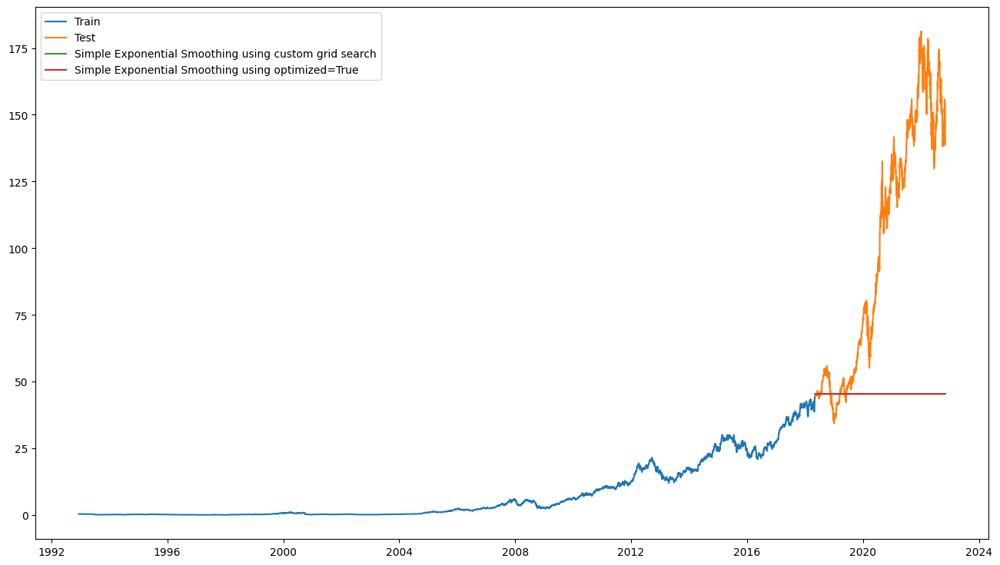

In [18]:
plt.rcParams["figure.figsize"] = [16,9]
plt.plot(X_train, label='Train')
plt.plot(X_test, label='Test')
plt.plot(df_fcst_gs_pred, label='Simple Exponential Smoothing using custom grid search')
plt.plot(df_fcst_auto_pred, label='Simple Exponential Smoothing using optimized=True')
plt.legend(loc='best')
plt.show()

## Double Exponential Smoothing

In [19]:
param_grid_DES = {'smoothing_level': [0.10, 0.20,.30,.40,.50,.60,.70,.80,.90], 
                  'smoothing_slope':[0.10, 0.20,.30,.40,.50,.60,.70,.80,.90],
                  'damping_slope': [0.10, 0.20,.30,.40,.50,.60,.70,.80,.90],
                  'damped': [True, False]}
pg_DES = list(ParameterGrid(param_grid_DES))

In [20]:
pg_DES

[{'damped': True,
  'damping_slope': 0.1,
  'smoothing_level': 0.1,
  'smoothing_slope': 0.1},
 {'damped': True,
  'damping_slope': 0.1,
  'smoothing_level': 0.1,
  'smoothing_slope': 0.2},
 {'damped': True,
  'damping_slope': 0.1,
  'smoothing_level': 0.1,
  'smoothing_slope': 0.3},
 {'damped': True,
  'damping_slope': 0.1,
  'smoothing_level': 0.1,
  'smoothing_slope': 0.4},
 {'damped': True,
  'damping_slope': 0.1,
  'smoothing_level': 0.1,
  'smoothing_slope': 0.5},
 {'damped': True,
  'damping_slope': 0.1,
  'smoothing_level': 0.1,
  'smoothing_slope': 0.6},
 {'damped': True,
  'damping_slope': 0.1,
  'smoothing_level': 0.1,
  'smoothing_slope': 0.7},
 {'damped': True,
  'damping_slope': 0.1,
  'smoothing_level': 0.1,
  'smoothing_slope': 0.8},
 {'damped': True,
  'damping_slope': 0.1,
  'smoothing_level': 0.1,
  'smoothing_slope': 0.9},
 {'damped': True,
  'damping_slope': 0.1,
  'smoothing_level': 0.2,
  'smoothing_slope': 0.1},
 {'damped': True,
  'damping_slope': 0.1,
  'smoot

In [21]:
df_results_DES = pd.DataFrame(columns=['smoothing_level', 'smoothing_slope', 'damping_slope', 'damped', 'RMSE','R²'])

for a,b in enumerate(pg_DES):
    smoothing_level = b.get('smoothing_level')
    smoothing_slope = b.get('smoothing_slope')
    damping_slope = b.get('damping_slope')
    damped = b.get('damped')
    
    fit_Holt = Holt(X_train, damped=damped).fit(smoothing_level=smoothing_level, smoothing_slope=smoothing_slope, damping_slope=damping_slope, optimized=False)
    fcst_gs_pred_Holt = fit_Holt.forecast(len(X_test))
    
    df_pred = pd.DataFrame(fcst_gs_pred_Holt, columns=['Forecasted_result'])
    RMSE = np.sqrt(metrics.mean_squared_error(X_test, df_pred.Forecasted_result))
    r2 = metrics.r2_score(X_test, df_pred.Forecasted_result)

    df_results_DES = df_results_DES.append({'smoothing_level':smoothing_level, 'smoothing_slope':smoothing_slope, 'damping_slope':damping_slope, 'damped':damped, 'RMSE':RMSE, 'R²':r2}, ignore_index=True)

/var/folders/rc/pqsyx_fx70b24dfplrpbwtf00000gp/T/ipykernel_8165/2372572241.py:9: FutureWarning: the 'damped'' keyword is deprecated, use 'damped_trend' instead.
  fit_Holt = Holt(X_train, damped=damped).fit(smoothing_level=smoothing_level, smoothing_slope=smoothing_slope, damping_slope=damping_slope, optimized=False)
/Users/junginseo/opt/anaconda3/envs/dl_env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/var/folders/rc/pqsyx_fx70b24dfplrpbwtf00000gp/T/ipykernel_8165/2372572241.py:9: FutureWarning: the 'smoothing_slope'' keyword is deprecated, use 'smoothing_trend' instead.
  fit_Holt = Holt(X_train, damped=damped).fit(smoothing_level=smoothing_level, smoothing_slope=smoothing_slope, damping_slope=damping_slope, optimized=False)
/Users/junginseo/opt/anaconda3/envs/dl_env/lib/python3.8/site-package

In [22]:
df_results_DES.sort_values(by=['RMSE','R²']).head(10)

,smoothing_level,smoothing_slope,damping_slope,damped,RMSE,R²
755,0.3,0.9,0.1,False,19.582501,0.817884
836,0.3,0.9,0.2,False,19.582501,0.817884
917,0.3,0.9,0.3,False,19.582501,0.817884
998,0.3,0.9,0.4,False,19.582501,0.817884
1079,0.3,0.9,0.5,False,19.582501,0.817884
1160,0.3,0.9,0.6,False,19.582501,0.817884
1241,0.3,0.9,0.7,False,19.582501,0.817884
1322,0.3,0.9,0.8,False,19.582501,0.817884
1403,0.3,0.9,0.9,False,19.582501,0.817884
729,0.1,0.1,0.1,False,22.213041,0.765669


In [23]:
best_values_DES = df_results_DES.sort_values(by=['RMSE','R²']).head(1)
best_values_DES

,smoothing_level,smoothing_slope,damping_slope,damped,RMSE,R²
755,0.3,0.9,0.1,False,19.582501,0.817884


In [24]:
smoothing_level_value_DES = best_values_DES['smoothing_level'].iloc[0]
smoothing_slope_value_DES = best_values_DES['smoothing_slope'].iloc[0]
damping_slope_value_DES = best_values_DES['damping_slope'].iloc[0]
damped_setting_DES = best_values_DES['damped'].iloc[0]

print("smoothing_level_value_DES: ", smoothing_level_value_DES)
print("smoothing_slope_value_DES: ", smoothing_slope_value_DES)
print("damping_slope_value_DES: ", damping_slope_value_DES)
print("damped_setting_DES: ", damped_setting_DES)

smoothing_level_value_DES:  0.3
smoothing_slope_value_DES:  0.9
damping_slope_value_DES:  0.1
damped_setting_DES:  False


In [25]:
DES = Holt(X_train,damped=damped_setting_DES)
fit_Holt = DES.fit(smoothing_level=smoothing_level_value_DES, smoothing_slope=smoothing_slope_value_DES, 
                   damping_slope=damping_slope_value_DES ,optimized=False)

fcst_gs_pred_Holt = fit_Holt.forecast(len(X_test))
timeseries_evaluation_metrics_func(X_test, fcst_gs_pred_Holt)

/var/folders/rc/pqsyx_fx70b24dfplrpbwtf00000gp/T/ipykernel_8165/3720440512.py:1: FutureWarning: the 'damped'' keyword is deprecated, use 'damped_trend' instead.
  DES = Holt(X_train,damped=damped_setting_DES)
/Users/junginseo/opt/anaconda3/envs/dl_env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/var/folders/rc/pqsyx_fx70b24dfplrpbwtf00000gp/T/ipykernel_8165/3720440512.py:2: FutureWarning: the 'smoothing_slope'' keyword is deprecated, use 'smoothing_trend' instead.
  fit_Holt = DES.fit(smoothing_level=smoothing_level_value_DES, smoothing_slope=smoothing_slope_value_DES,
/Users/junginseo/opt/anaconda3/envs/dl_env/lib/python3.8/site-packages/pandas/util/_decorators.py:207: FutureWarning: the 'damping_slope'' keyword is deprecated, use 'damping_trend' instead.
  return func(*args, **kwargs)
/Users/j

Evaluation metric results: 
MSE is : 383.47433179991134
MAE is : 16.771148644407194
RMSE is : 19.582500652365912
MAPE is : 20.93411873112386
R2 is : 0.8178835514512754



In [26]:
DES = Holt(X_train)
fit_Holt_auto = DES.fit(optimized= True, use_brute = True)

fcst_auto_pred_Holt = fit_Holt_auto.forecast(len(X_test))
timeseries_evaluation_metrics_func(X_test, fcst_auto_pred_Holt)

Evaluation metric results: 
MSE is : 3252.309950074207
MAE is : 43.69132280459026
RMSE is : 57.02902725870578
MAPE is : 34.433565205751734
R2 is : -0.5445600619658773



/Users/junginseo/opt/anaconda3/envs/dl_env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/Users/junginseo/opt/anaconda3/envs/dl_env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


In [27]:
fit_Holt_auto.summary()

Dep. Variable:,Adj Close,No. Observations:,6400
Model:,Holt,SSE,251.528
Optimized:,True,AIC,-20705.599
Trend:,Additive,BIC,-20678.543
Seasonal:,None,AICC,-20705.586
Seasonal Periods:,None,Date:,"Wed, 09 Nov 2022"
Box-Cox:,False,Time:,14:16:43
Box-Cox Coeff.:,None,,
,coeff,code,optimized
smoothing_level,1.0000000,alpha,True
smoothing_trend,0.0010362,beta,True


In [28]:
fcst_gs_pred_Holt.index =  X_test.index
fcst_auto_pred_Holt.index = X_test.index

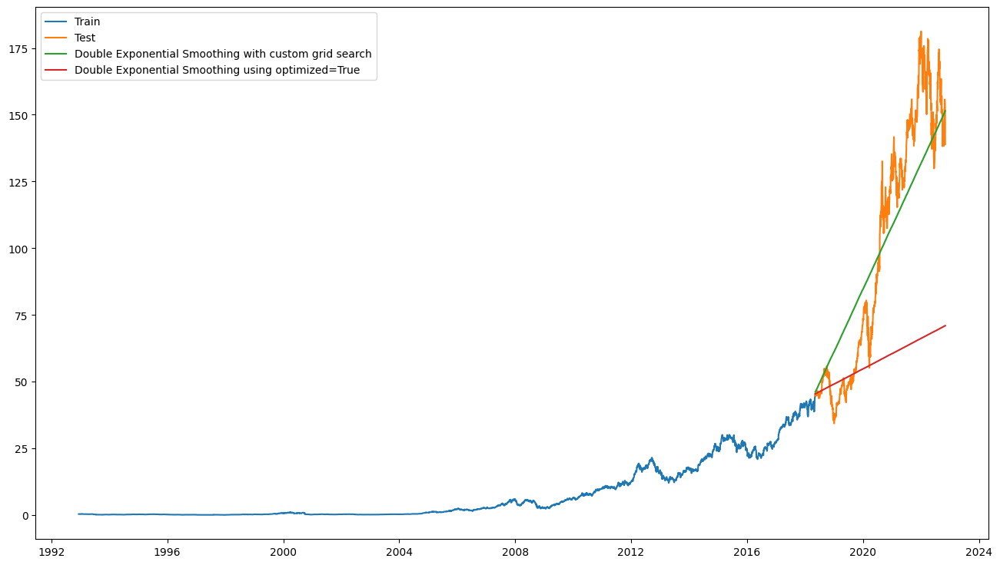

In [29]:
plt.rcParams["figure.figsize"] = [16,9]
plt.plot(X_train, label='Train')
plt.plot(X_test, label='Test')
plt.plot(fcst_gs_pred_Holt, label='Double Exponential Smoothing with custom grid search')
plt.plot(fcst_auto_pred_Holt, label='Double Exponential Smoothing using optimized=True')
plt.legend(loc='best')
plt.show()

### Triple Exponential Smoothing

In [30]:
param_grid_TES = {'trend': ['add', 'mul'], 'seasonal' :['add', 'mul'],
                  'seasonal_periods':[3,6,12], 
                  'smoothing_level': [.20, .40, .60, .80],  # extended search grid: [.10,.20,.30,.40,.50,.60,.70,.80,.90]
                  'smoothing_slope':[.20, .40, .60, .80],   # extended search grid: [.10,.20,.30,.40,.50,.60,.70,.80,.90]
                  'damping_slope': [.20, .40, .60, .80],    # extended search grid: [.10,.20,.30,.40,.50,.60,.70,.80,.90]
                  'damped' : [True, False], 'use_boxcox':[True, False],
                  'remove_bias':[True, False],'use_basinhopping':[True, False]}
pg_TES = list(ParameterGrid(param_grid_TES))

In [35]:
df_results_TES = pd.DataFrame(columns=['trend','seasonal_periods','smoothing_level', 'smoothing_slope',
                                        'damping_slope','damped','use_boxcox','remove_bias',
                                        'use_basinhopping','RMSE','R²'])

for a,b in enumerate(pg_TES):
    trend = b.get('trend')
    smoothing_level = b.get('smoothing_level')
    seasonal_periods = b.get('seasonal_periods')
    smoothing_level = b.get('smoothing_level')
    smoothing_slope = b.get('smoothing_slope')
    damping_slope = b.get('damping_slope')
    damped = b.get('damped')
    use_boxcox = b.get('use_boxcox')
    remove_bias = b.get('remove_bias')
    use_basinhopping = b.get('use_basinhopping')

    fit_ES = ExponentialSmoothing(X_train, trend=trend, damped=damped, seasonal_periods=seasonal_periods).fit(smoothing_level=smoothing_level,
                                  smoothing_slope=smoothing_slope, damping_slope=damping_slope, optimized=False) 
    fcst_gs_pred_ES = fit_ES.forecast(len(X_test))

    df_pred = pd.DataFrame(fcst_gs_pred_ES, columns=['Forecasted_result'])
    RMSE = np.sqrt(metrics.mean_squared_error(X_test, df_pred.Forecasted_result))
    r2 = metrics.r2_score(X_test, df_pred.Forecasted_result)

    df_results_TES = df_results_TES.append({'trend':trend, 'seasonal_periods':seasonal_periods, 'smoothing_level':smoothing_level, 
                                            'smoothing_slope':smoothing_slope, 'damping_slope':damping_slope,'damped':damped,
                                            'use_boxcox':use_boxcox, 'remove_bias':remove_bias, 'use_basinhopping':use_basinhopping, 'RMSE':RMSE,'R²':r2}, 
                                            ignore_index=True)

/var/folders/rc/pqsyx_fx70b24dfplrpbwtf00000gp/T/ipykernel_8165/152963989.py:17: FutureWarning: the 'damped'' keyword is deprecated, use 'damped_trend' instead.
  fit_ES = ExponentialSmoothing(X_train, trend=trend, damped=damped, seasonal_periods=seasonal_periods).fit(smoothing_level=smoothing_level,
/Users/junginseo/opt/anaconda3/envs/dl_env/lib/python3.8/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/var/folders/rc/pqsyx_fx70b24dfplrpbwtf00000gp/T/ipykernel_8165/152963989.py:17: FutureWarning: the 'smoothing_slope'' keyword is deprecated, use 'smoothing_trend' instead.
  fit_ES = ExponentialSmoothing(X_train, trend=trend, damped=damped, seasonal_periods=seasonal_periods).fit(smoothing_level=smoothing_level,
/Users/junginseo/opt/anaconda3/envs/dl_env/lib/python3.8/site-packages/pandas/util/_decorators.py:207: 